# Busecke and Balwada et al. GRL Resubmission for revisions

Instructions to run this notebook: 
For exact reproducibility run this in the `quay.io/jbusecke/scale-aware-air-sea:68b654d76dce` docker image and install the [scale-aware-air-sea packge]() from the `revision` tag:
```shell
pip install ....
```
- [ ] TODO: Enter the tagged install once everything runs 
- [ ] Remove autoreload
- [ ] Switch to the publication bucket once the data is moved (also remove the mentions of aws profiles etc.)

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# !pip install -e .

I dont think I need the following anymore?

In [3]:
# !pip install -e /home/jovyan/PROJECTS/scale-aware-air-sea --no-deps

In [4]:
# # until the new xarrayutils is released
# !pip install git+https://github.com/jbusecke/xarrayutils.git

In [5]:
# # Reproducibility info (only works on the hub)
# import os

# os.environ["JUPYTER_IMAGE"]

In [26]:
# # shut up all these annoying warnings. Yes out graph is big! Stuff still works as far as I can tell.
# import dask
# dask.config.set({'logging.distributed.client':'error'})
# This does not work, bring out the big guns
import warnings
warnings.simplefilter(action="ignore")
#########
import xarray as xr
import pandas as pd
import numpy as np
import cartopy
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from scale_aware_air_sea.parameters import get_params
from scale_aware_air_sea.plotting import fill_da
from scale_aware_air_sea.plotting import centered_shrink_axes
from distributed import Client
import gcsfs
from scipy.ndimage import binary_dilation
from xarrayutils.plotting import letter_subplots, box_plot
from matplotlib.axes._axes import Axes
from xhistogram.xarray import histogram
import functools

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [7]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 7.65 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:46087,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 7.65 GiB
Comm: tcp://127.0.0.1:36525,Total threads: 2
Dashboard: http://127.0.0.1:41855/status,Memory: 1.91 GiB
Nanny: tcp://127.0.0.1:43605,


In [44]:
# load global parameters
## Plot quality
n_subsample = 5  # set to 1 for final (somehow the nans at the pole will be weirdly colored for any values that is not a multiple of 5 here..)
cartopy_scale = 50  # set to 50 for final
subsample = dict(
    xt_ocean=slice(0, None, n_subsample), yt_ocean=slice(0, None, n_subsample)
)
wbc_boxes = [(-85, -40, 25, 45), (-235, -190, 25, 45)]

map_width = 8
map_aspect = 1.9
map_height = map_width / map_aspect
#
projection = ccrs.Robinson(200)
primary_algo = "ecmwf"

savefig_kwargs = dict(
    dpi=150,
)

params = get_params("v1.0.1", test=False)
models = ["CM26", "CESM"]
open_kwargs = dict(
    engine="zarr",
    chunks={},
)
label_dict = {
    "ql": "Latent Heatflux [$W/m^2$]",
    "qh": "Sensible Heatflux [$W/m^2$]",
    "q_total": "Turbulent Heatflux\n(Sensible + Latent) [$W/m^2$]",
}
vmax_dict = {
    "ql": {"full": 180, "small": 10},
    "qh": {"full": 50, "small": 5},
    "q_total": {"full": 200, "small": 20},
}
bins_dict = {"ql": np.linspace(-30, 20, 200), "qh": np.linspace(-10, 5, 200)}

letter_subplots_kwargs = dict(
    box_color="0.5",
    fontsize=14,
    x=0.05,
    y=0.95,
    horizontalalignment="left",
    verticalalignment="top",
)

### Utility funcs

In [45]:
from scipy.ndimage import gaussian_filter


def fill_lon_lat(ds: xr.Dataset) -> xr.Dataset:

    # patch lon
    lon = ds.geolon_t.load()
    lon = lon.where(lon < 250, -360 + lon)

    # lon_filled = fill_da(lon)
    lon_interp = lon.interpolate_na("yt_ocean").interpolate_na("xt_ocean")
    lon_filled = fill_da(lon_interp)

    lon_patch = lon_filled.copy()
    lon_patch.data = gaussian_filter(lon_patch.data, 20)

    lon_patched = lon.where(~np.isnan(lon), lon_patch)
    lon_patched = lon_patched.reset_coords(drop=True)

    # patch lat
    lat = ds.geolat_t.load()

    lat_interp = (
        lat.roll(xt_ocean=700)
        .interpolate_na("xt_ocean")
        .roll(xt_ocean=-700)
        .interpolate_na("yt_ocean")
    )
    lat_filled = fill_da(lat_interp)

    lat_patch = lat_filled.copy()
    lat_patch.data = gaussian_filter(lat_patch.data, 50)

    lat_patched = lat.where(~np.isnan(lat), lat_patch)

    lat_patched = lat_patched.reset_coords(drop=True)

    ds = ds.assign_coords(geolon_t=lon_patched, geolat_t=lat_patched)
    return ds


def global_ave(ds: xr.Dataset) -> xr.Dataset:
    return ds.weighted(ds.area_t).mean(["xt_ocean", "yt_ocean"])





def hist_plot(
    da: xr.DataArray,
    bins: np.ndarray,
    label: str,
    ax: Axes,
    kwargs: dict = None,
) -> Axes:
    if not kwargs:
        kwargs = {"alpha": 0.5}
    # block_size=None should avoid the division by 0 error https://github.com/xgcm/xhistogram/issues/16
    hist = histogram(da, bins=bins, density=True, block_size=None)
    hist.plot(ax=ax, label=label, **kwargs)
    return ax


def _add_global_mean_to_map(
    da: xr.DataArray,
    ax: Axes,
    ice_mask: xr.DataArray,
    x: float = 0.14,
    y: float = 0.75,
):
    mean_da = global_ave(da).load()
    if not ice_mask is None:
        masked = da.where(ice_mask)
        mean_da_wo_ice = global_ave(masked).load()
        text = f"{mean_da.data:.2f} $W/m^2$\n({mean_da_wo_ice.data:.2f} $W/m^2$)"
    else:
        text = f"{mean_da.data:.2f} $W/m^2$"

    ax.text(
        x,
        y,
        text,
        ha="left",
        va="bottom",
        fontsize=5,
        transform=ax.transAxes,
        bbox=dict(facecolor="white", alpha=0.8),
    )


def add_total(ds: xr.Dataset) -> xr.Dataset:
    ds["q_total"] = ds["ql"] + ds["qh"]
    return ds


def decomposition_map_plot(
    ds: xr.Dataset, ice_mask: xr.DataArray, variables: list[str]
):
    ds_plot_mean = ds.sel(algo=primary_algo)
    nvar = len(variables)
    fig, axarr = plt.subplots(
        figsize=[nvar * map_width, 3 * map_height],
        ncols=nvar,
        nrows=3,
        subplot_kw={"projection": projection},
    )
    ax_columns = [axarr[:, i].flat for i in range(nvar)] if nvar > 1 else [axarr.flat]
    for var, (ax_atmos, ax_ocean, ax_coupled) in zip(variables, ax_columns):
        vmax_full = vmax_dict[var]["small"]
        da_full = ds_plot_mean[var].sel(term="Q_star_star")
        da_ocean = ds_plot_mean[var].sel(term="Q_star_star_ocean")
        da_atmos = ds_plot_mean[var].sel(term="Q_star_star_atmos")
        da_coupled = ds_plot_mean[var].sel(term="Q_star_star") - da_ocean - da_atmos

        # Map Plot
        for da, ax, vmax, component in [
            (da_atmos, ax_atmos, vmax_full * 2 / 3, "Atmosphere contribution"),
            (da_ocean, ax_ocean, vmax_full * 2 / 3, "Ocean contribution"),
            (da_coupled, ax_coupled, vmax_full * 2 / 3 / 4, "Coupled contribution"),
        ]:
            map_plot(da, ax, label_dict[var], vmax, ice_mask)
            ax.set_title(component)

            # add global mean value
            _add_global_mean_to_map(da, ax, ice_mask)
    letter_subplots(axarr, **letter_subplots_kwargs)
    return fig


def appendix_decomposition_map_plot(ds: xr.Dataset, ice_mask: xr.DataArray, var):
    ds_plot_mean = ds.sel(algo=primary_algo)
    fig, axarr = plt.subplots(
        figsize=[2 * map_width, 3 * map_height],
        ncols=2,
        nrows=3,
        subplot_kw={"projection": projection},
    )

    da_ocean = ds_plot_mean[var].sel(term="Q_star_star_ocean")
    da_atmos = ds_plot_mean[var].sel(term="Q_star_star_atmos")
    da_tracer = ds_plot_mean[var].sel(term="Q_star_star_tracer")
    da_vel = ds_plot_mean[var].sel(term="Q_star_star_vel")
    da_coupled = ds_plot_mean[var].sel(term="Q_star_star") - da_ocean - da_atmos

    vmax_raw = vmax_dict[var]["small"]

    inputs = [
        (da_atmos, vmax_raw * 2 / 3, "Atmosphere contribution"),
        (da_vel, vmax_raw * 2 / 3, "Velocity contribution"),
        (da_ocean, vmax_raw * 2 / 3, "Ocean contribution"),
        (da_tracer, vmax_raw * 2 / 3, "Tracer contribution"),
        (da_coupled, vmax_raw * 2 / 3 / 4, "Coupled contribution"),
    ]

    for (da, vmax, component), ax in zip(inputs, axarr.flat):
        map_plot(da, ax, label_dict[var], vmax, ice_mask)
        ax.set_title(component)

        # add global mean value
        _add_global_mean_to_map(da, ax, ice_mask)
    letter_subplots(axarr, **letter_subplots_kwargs)
    return fig, axarr


def mask_boxes(ds:xr.Dataset, boxes: list[tuple[float, float, float, float]]) -> xr.DataArray:
    """Masks out a list of boxes provided as  (lon_min, lon_max, lat_min, lat_max) values"""
    lon = ds.geolon_t
    lat = ds.geolat_t
    # detect the data lon convention
    lon_min = lon.min().load()
    box_lon_min = min([b[0] for b in boxes])
    # adjust the lon convention for the boxes if values are out of bound
    # this does not currently cover all cases, so check carefully!
    if lon_min>box_lon_min:
        boxes = [(b[0]+360, b[1]+360, b[2], b[3]) for b in boxes]
    global_min_lon = [b[0] for b in boxes]
    # create a mask for each box
    masks = []
    for box in boxes:
        lon_min, lon_max, lat_min, lat_max = box
        mask_single = np.logical_and(np.logical_and(lat>lat_min, lat<lat_max), np.logical_and(lon>lon_min, lon<lon_max))
        masks.append(mask_single)
    mask_combined = functools.reduce(np.logical_or, masks)
    return mask_combined

def quadrant_count(counts, x, y, strong_criterion=0.1):
    """Split histogram cell counts into 'enforcing' (having the same sign) 
    and 'dampening' (having opposite signs).
    Will also further split the 'enforcing' into 'strong' (y>strong_criterion*x)
    """
    # assuming that 2d arrays are passed
    assert len(counts.dims) <= 2
    assert len(x.dims) == 1
    assert len(y.dims) == 1
    assert set(x.dims).issubset(counts.dims)
    assert set(y.dims).issubset(counts.dims)

    full_count = counts.sum().load().data
    xx, yy = xr.broadcast(x,y)
    enforcing_quadrant_mask = np.sign(xx) == np.sign(yy)
    masks = {
        'enforcing':enforcing_quadrant_mask,
        'strong_enforcing':enforcing_quadrant_mask & (
            abs(yy) > abs(xx) * strong_criterion
        )
    }
    masked_counts = {
        k:counts.where(mask).sum().load().data for k, mask in masks.items() 
    }
    masked_counts_rel = {k: count/full_count*100 for k, count in masked_counts.items()}
    return masked_counts_rel

def map_plot(
    da: xr.DataArray,
    ax: Axes,
    label: str,
    vmax: float,
    ice_mask: xr.DataArray,
    fill: bool = True,
    add_mean: bool = True,
    plot_boxes: bool = False,
    nan_color: str = 'purple',
    **kwargs,
) -> Axes:
    # properly pad the nans in lon/lat
    if fill:
        da = fill_lon_lat(da)

    if ice_mask is not None:
        # try to fix the ice mask by taking the landmass out
        land_mask = np.isnan(da)
        new_mask = (land_mask + ice_mask) == 1
        new_mask = new_mask.assign_coords(
            geolon_t=da.geolon_t.reset_coords(drop=True),
            geolat_t=da.geolat_t.reset_coords(drop=True),
        )
        ice_mask = new_mask

    da_sub = da.copy()
    da_sub = da_sub.isel(**subsample)

    nan_mask = np.isnan(da_sub)

    plot_kwargs = dict(
        ax=ax,
        transform=ccrs.PlateCarree(),
        x="geolon_t",
        y="geolat_t",
    )

    # handle cbar_label input (this is a bit janky but should be backwards compatible)
    kwargs["cbar_kwargs"] = {"label": label} | kwargs.get("cbar_kwargs", {})
    
    da_sub.plot(**plot_kwargs, vmax=vmax, center=0, rasterized=True, zorder=1,infer_intervals=False, **kwargs)
    
    if not ice_mask is None:
        # # erode the ice mask to get rid of the small island (only affects the visuals)
        ice_mask_plot = ice_mask
        # ice_mask_plot = ice_mask.copy(deep=True)
        # ice_mask_plot.data = binary_dilation(ice_mask_plot.data, iterations=5)
        ice_mask_plot.plot.contour(
            **plot_kwargs, levels=[0.01], colors="orange", linewidths=0.5
        )

    if add_mean:
        _add_global_mean_to_map(da, ax, ice_mask)

    ax.add_feature(
        cartopy.feature.NaturalEarthFeature(
            category="physical",
            name="land",
            scale=f"{cartopy_scale}m",
            facecolor="0.3",
            edgecolor="0.1",
            linewidth=0.5,
        ),
        zorder=2,
    )

    if plot_boxes:
        for box in wbc_boxes:
            box_plot(np.array(box),ax, transform=plot_kwargs['transform'], color='0.5')

    return ax

## Setup filesystem to read from OSN bucket
Currently requires authentication set up in the `~/.aws/credentials` file. See [here](https://leap-stc.github.io/guides/data_guides/external_workflow.html#authentication) for details. 

>![note]
> Make sure to match/adjust the profile name in the file and the fsspec call below!

In [46]:
import fsspec
fs = fsspec.filesystem(
    's3',
    profile='osn-read',  ## The profile name that is configured in the aws credentials file.
    client_kwargs={'endpoint_url': 'https://nyu1.osn.mghpcc.org'} # This is the endpoint for the m2lines osn pod
)

## Reload the processed plot data

In [47]:
max_ice_mask = {}
# save max_ice_mask to storage
for model in models:
    path = params["paths"][model]["plotting"]["max_ice_mask"]
    da = xr.open_dataset(fs.get_mapper(path), **open_kwargs).max_extent_ice_mask
    max_ice_mask[model] = da

In [48]:
# full flux output
full_flux = {}
for model in models:
    full_flux[model] = {}
    for computed in ["online", "offline"]:
        full_flux[model][computed] = {}
        for mean in ["time_mean", "global_mean"]:
            path = params["paths"][model]["plotting"]["full_fluxes"][computed][mean]
            ds = xr.open_dataset(fs.get_mapper(path), **open_kwargs)
            full_flux[model][computed][mean] = ds

## Plots

### Explain the method with Snapshot examples of small scale air sea flux

In [49]:
path

'scale-aware-air-sea/jbusecke/v1.0.1/plotting/CESM_full_flux_offline_global_mean.zarr'

In [51]:
# for model in models:
for model in ["CM26"]:
    path = params["paths"][model]["results"]["filter"]["native"]["all_terms"]
    ds = add_total(xr.open_dataset(fs.get_mapper(path), engine="zarr", chunks={}))
    # select a few timesteps, the first algo, and only the Q^** term
    ds_plot = ds.isel(algo=0, time=slice(0, 4)).load()

    # do this here and deactivate on map plot to save time
    ds_plot = fill_lon_lat(ds_plot)
    # preload the data for plotting
    ds_plot = ds_plot.load()

    n_time = len(ds_plot.time)
    map_multiplier = 6

    # for var in ['q_total', 'ql', 'qh']:
    for var in ["q_total"]:

        da = ds_plot[var]

        fig = plt.figure(
            figsize=[
                3 * map_width,
                (map_height * n_time) + (map_height / map_multiplier),
            ]
        )
        gs = fig.add_gridspec((n_time * map_multiplier) + 1, 3)

        axarr_full = [
            fig.add_subplot(gs[i : i + map_multiplier, 0], projection=projection)
            for i in range(0, n_time * map_multiplier, map_multiplier)
        ]
        axarr_large = [
            fig.add_subplot(gs[i : i + map_multiplier, 1], projection=projection)
            for i in range(0, n_time * map_multiplier, map_multiplier)
        ]
        axarr_small = [
            fig.add_subplot(gs[i : i + map_multiplier, 2], projection=projection)
            for i in range(0, n_time * map_multiplier, map_multiplier)
        ]

        ax_cbar_large = fig.add_subplot(gs[-1, 0:2])
        ax_cbar_small = fig.add_subplot(gs[-1, 2])

        for term, axarr, vmax, cbar_ax in [
            ("Q_H_bar", axarr_full, vmax_dict[var]["full"], ax_cbar_large),
            ("Q_L_bar", axarr_large, vmax_dict[var]["full"], ax_cbar_large),
            ("Q_star_star", axarr_small, vmax_dict[var]["small"], ax_cbar_small),
        ]:
            for time, ax in zip(da.time, axarr):
                map_plot(
                    da.sel(term=term, time=time),
                    ax,
                    label_dict[var],
                    vmax * 1.5,
                    ice_mask=max_ice_mask["CM26"],
                    cbar_ax=cbar_ax,
                    cbar_kwargs={
                        "orientation": "horizontal",
                        "shrink": 0.3,
                        "extend": "both",
                    },
                    fill=False,
                )
                ax.set_title("")
        axarr_full[0].set_title("Full Flux $\overline{Q}$")
        axarr_large[0].set_title("Large Scale Flux $\overline{Q^C}$")
        axarr_small[0].set_title("Small Scale Flux $Q^*$")

        for ax in axarr_full:
            ax.set_ylabel(time)
        plt.savefig(
            f"figures_submission/daily_examples_{model.lower()}_{var}.png",
            **savefig_kwargs,
        )
        plt.show()

KeyboardInterrupt: 

## Appendix Plot 1: Full fluxes online vs offline global mean

### Global Mean Timeseries 

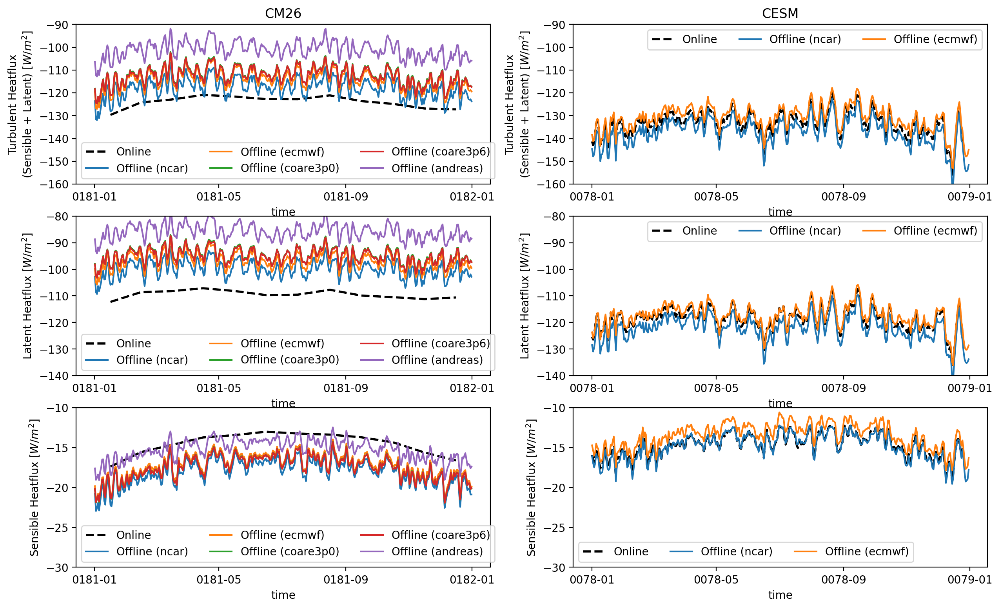

In [ ]:
fig, axarr = plt.subplots(ncols=2, nrows=3, figsize=[15, 9])

for model, axcol in zip(models, [axarr[:, 0], axarr[:, 1]]):
    for var, ax in zip(["q_total", "ql", "qh"], axcol):
        ds = full_flux[model]["online"]["global_mean"]
        da = add_total(ds)[var]
        da.plot(label="Online", ax=ax, lw=2, ls="--", color="k")

        ds_offline = full_flux[model]["offline"]["global_mean"]
        da_offline = add_total(ds_offline)[var]
        for algo in da_offline.algo.data:
            da_offline.sel(algo=algo).plot(label=f"Offline ({algo})", ax=ax)

        ax.set_ylabel(label_dict[var])

        if var == "q_total":
            ax.set_title(model)
        else:
            ax.set_title("")

for ax in axarr[0, :].flat:
    ax.set_ylim(-160, -90)

for ax in axarr[1, :].flat:
    ax.set_ylim(-140, -80)

for ax in axarr[2, :].flat:
    ax.set_ylim(-30, -10)

for ax in axarr.flat:
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, labels, ncols=3, loc="best")

plt.savefig(f"figures_submission/offline_online_timeseries.png", **savefig_kwargs)

## Appendix Plot 2: Full fluxes online vs offline time mean maps

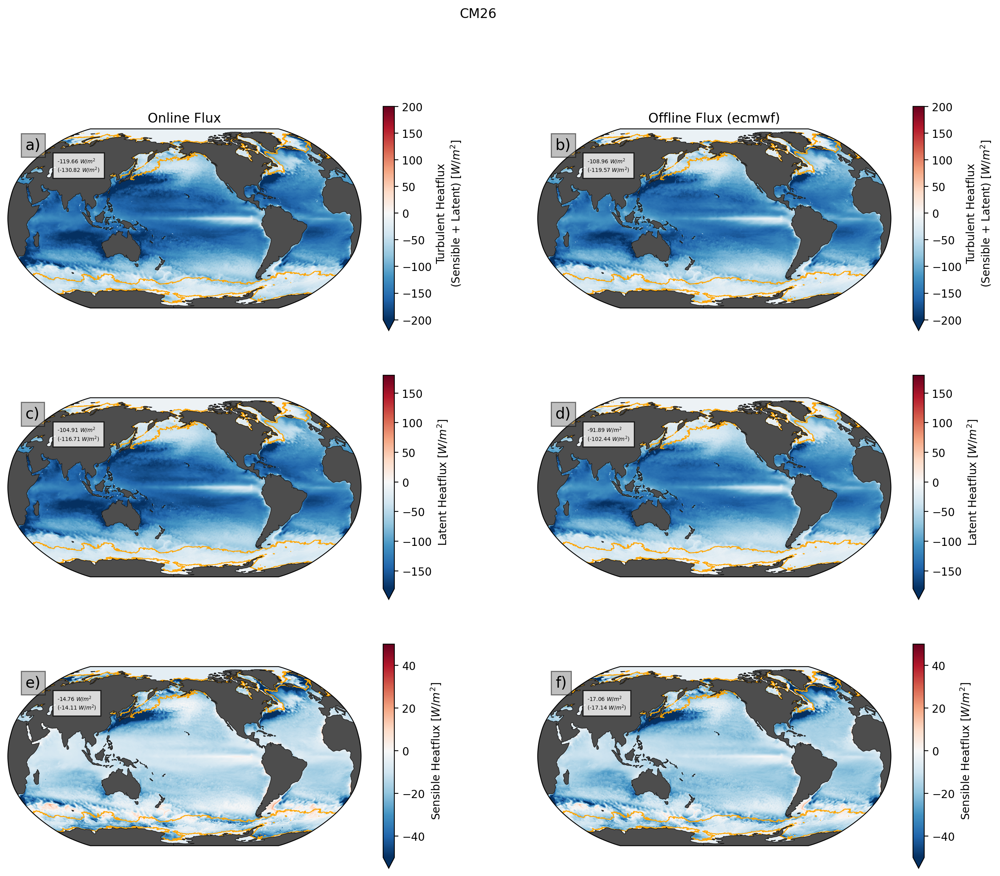

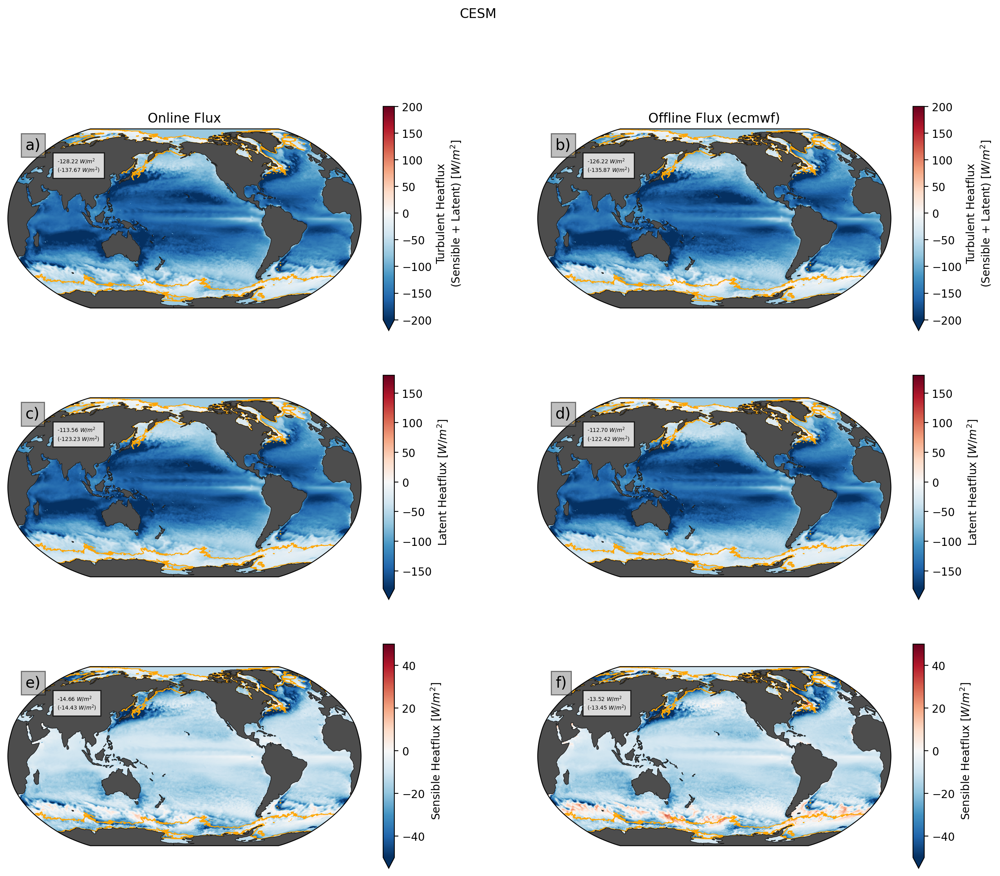

In [ ]:
for model in models:
    fig, axarr = plt.subplots(
        ncols=2,
        nrows=3,
        figsize=[2 * map_width, 3 * map_height],
        subplot_kw={"projection": projection},
    )
    for computed, axcol in [("online", axarr[:, 0]), ("offline", axarr[:, 1])]:
        ds = add_total(full_flux[model][computed]["time_mean"])
        if computed == "offline":
            ds = ds.sel(algo=primary_algo)
        ds = fill_lon_lat(ds).load()
        for var, ax in zip(["q_total", "ql", "qh"], axcol):
            map_plot(
                ds[var],
                ax,
                label_dict[var],
                vmax_dict[var]["full"],
                ice_mask=max_ice_mask[model],
                # cbar_ax = cbar_ax,
                # cbar_kwargs={'orientation':'horizontal', 'shrink': 0.3, 'extend':'both'},
                fill=False,
            )
            ax.set_title("")
        axarr[0, 0].set_title("Online Flux")
        axarr[0, 1].set_title(f"Offline Flux ({primary_algo})")
    letter_subplots(axarr, **letter_subplots_kwargs)
    fig.suptitle(model)
    plt.savefig(
        f"figures_submission/offline_online_map_{model.lower()}.png", **savefig_kwargs
    )
    plt.show()

## Appendix: Uncertainty on global ASSC flux
### filtered vs coarsened for all algos

In [ ]:
# plot timeseries
def ts(ds):
    return global_ave(ds).rolling(time=30).mean()


model = "CM26"
ds_filter = add_total(
    xr.open_dataset(
        params["paths"][model]["results"]["filter"]["native"]["appendix"], **open_kwargs
    )
)
ds_coarsen = add_total(
    xr.open_dataset(
        params["paths"][model]["results"]["coarse"]["native"]["appendix"], **open_kwargs
    )
)

timeseries_filter = ts(
    ds_filter.sel(term="Q_star_star")[["ql", "qh", "q_total"]]
).load()
timeseries_coarsen = ts(
    ds_coarsen.sel(term="Q_star_star")[["ql", "qh", "q_total"]]
).load()

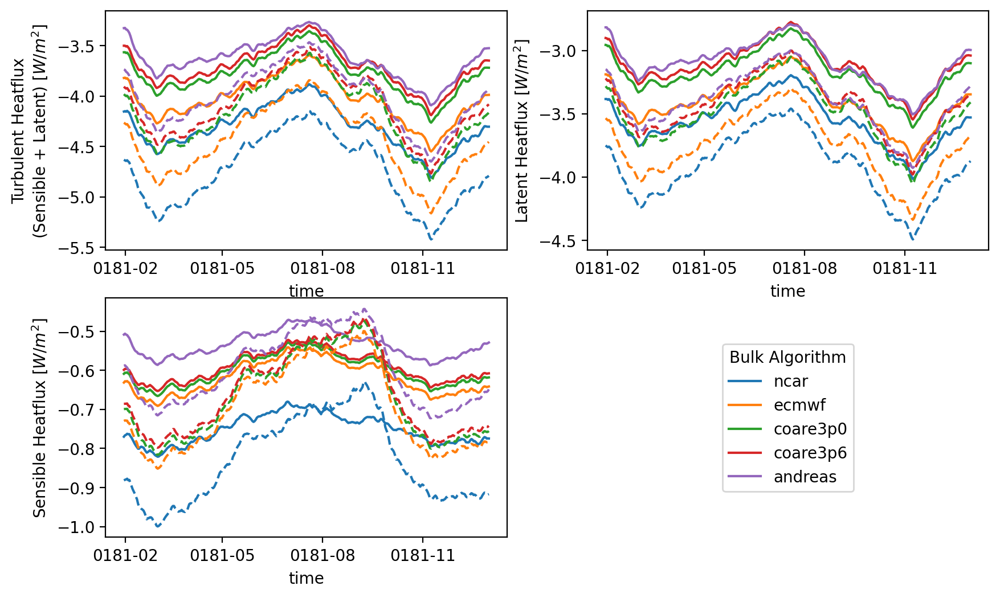

In [ ]:
fig, axarr = plt.subplots(ncols=2, nrows=2, figsize=[10, 6])

for var, ax in [("q_total", axarr[0, 0]), ("ql", axarr[0, 1]), ("qh", axarr[1, 0])]:
    handles = timeseries_filter[var].plot(ax=ax, hue="algo", add_legend=False)
    ax.set_prop_cycle(None)
    timeseries_coarsen[var].plot(ax=ax, hue="algo", ls="--", add_legend=False)
    ax.set_title("")
    ax.set_ylabel(label_dict[var])


# plot the legend in the lower right corner:
ax = axarr.flat[-1]
ax.legend(
    handles=handles,
    labels=list(ds_filter.algo.data),
    loc="center",
    title="Bulk Algorithm",
)
# Remove axis labels
ax.set_xlabel("")
ax.set_ylabel("")

# Remove ticks and tick labels
ax.set_xticks([])
ax.set_yticks([])
ax.set_xticklabels([])
ax.set_yticklabels([])

# Remove axis lines
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)
plt.savefig(
    f"figures_submission/filter_vs_coarsen_{model.lower()}.png", **savefig_kwargs
)

## Paper Plot 1: Mean maps and histograms

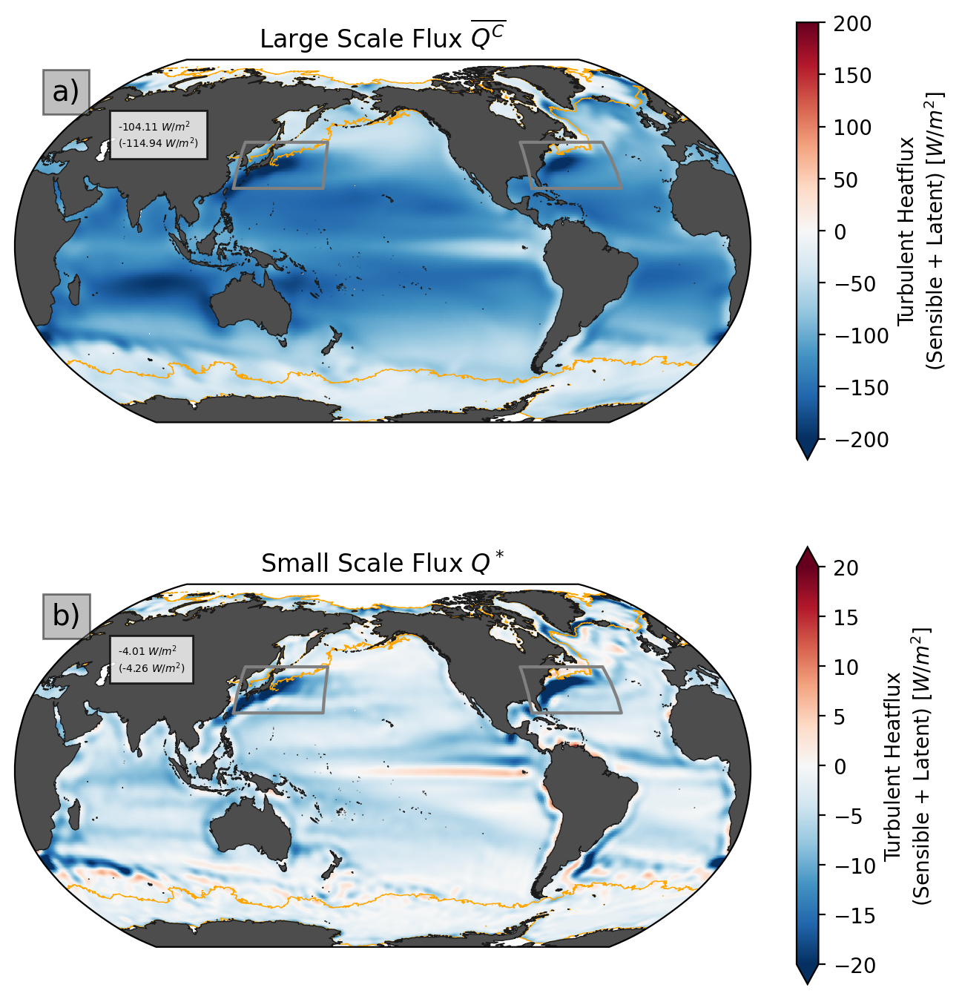

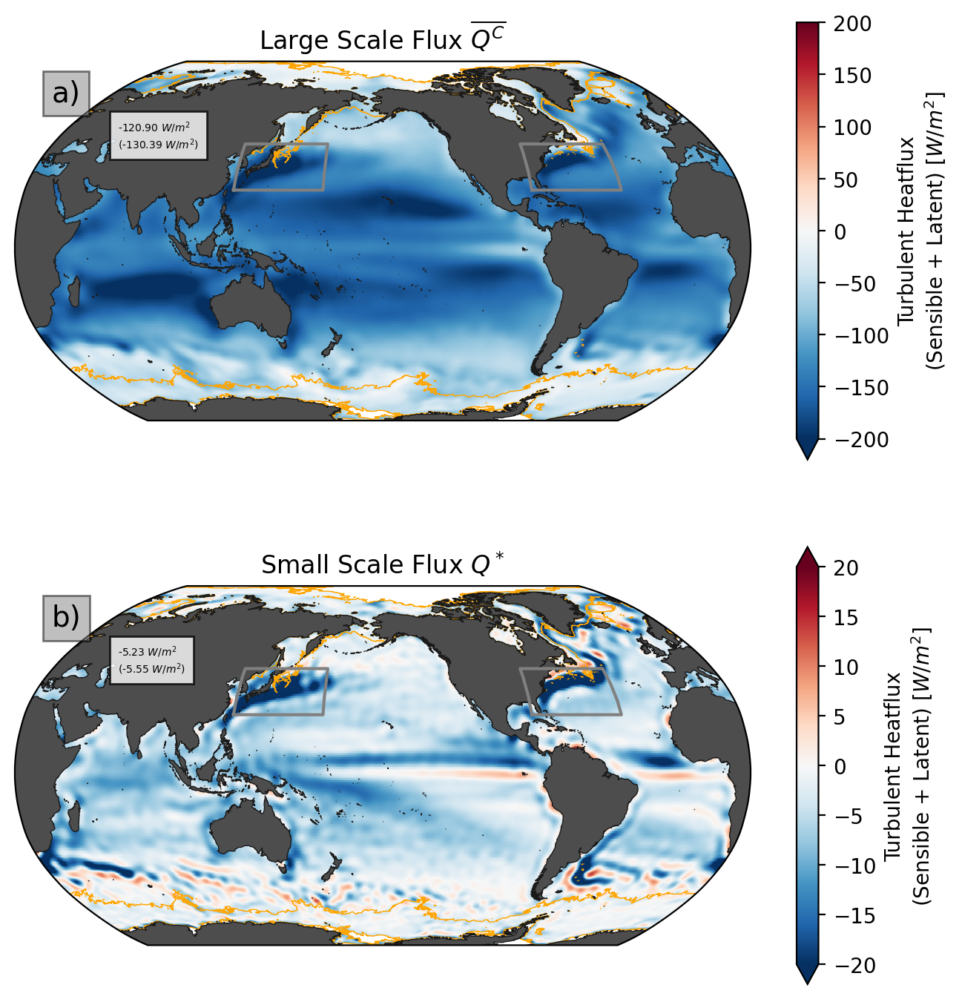

In [ ]:
scale_factor = 1
for model in models:
    small_scale_mean_prod = xr.open_dataset(
        params["paths"][model]["results"]["filter"]["mean"]["prod"], **open_kwargs
    )
    ds_plot_mean = add_total(small_scale_mean_prod)
    # recover the large scale term (which I did not save separately)
    Q_L_bar_recovered = (
        ds_plot_mean.sel(term="Q_H_bar") - ds_plot_mean.sel(term="Q_star_star")
    ).assign_coords(term="Q_L_bar")
    ds_plot_mean = xr.concat([ds_plot_mean, Q_L_bar_recovered], dim="term")
    ds_plot_mean = fill_lon_lat(ds_plot_mean)
    for var in ["q_total"]:
        fig, axarr = plt.subplots(
            ncols=1,
            nrows=2,
            figsize=[map_width * scale_factor, 2 * map_height * scale_factor],
            subplot_kw=dict(projection=projection),
        )

        for ax, term, vmax, title in [
            # (axarr.flat[0], 'Q_H_bar',vmax_dict[var]['full'], 'Full Resolution Flux'),
            (
                axarr.flat[0],
                "Q_L_bar",
                vmax_dict[var]["full"],
                "Large Scale Flux $\overline{Q^C}$",
            ),
            (
                axarr.flat[1],
                "Q_star_star",
                vmax_dict[var]["small"],
                "Small Scale Flux $Q^*$",
            ),
        ]:
            da_raw = ds_plot_mean[var].sel(term=term, algo=primary_algo)
            ax = map_plot(
                da_raw, ax, label_dict[var], vmax, max_ice_mask[model], fill=False, plot_boxes=True
            )
            ax.set_title(title)
        letter_subplots(axarr, **letter_subplots_kwargs)
        plt.savefig(f"figures_submission/mean_results_{model.lower()}.png", **savefig_kwargs)
        plt.show()

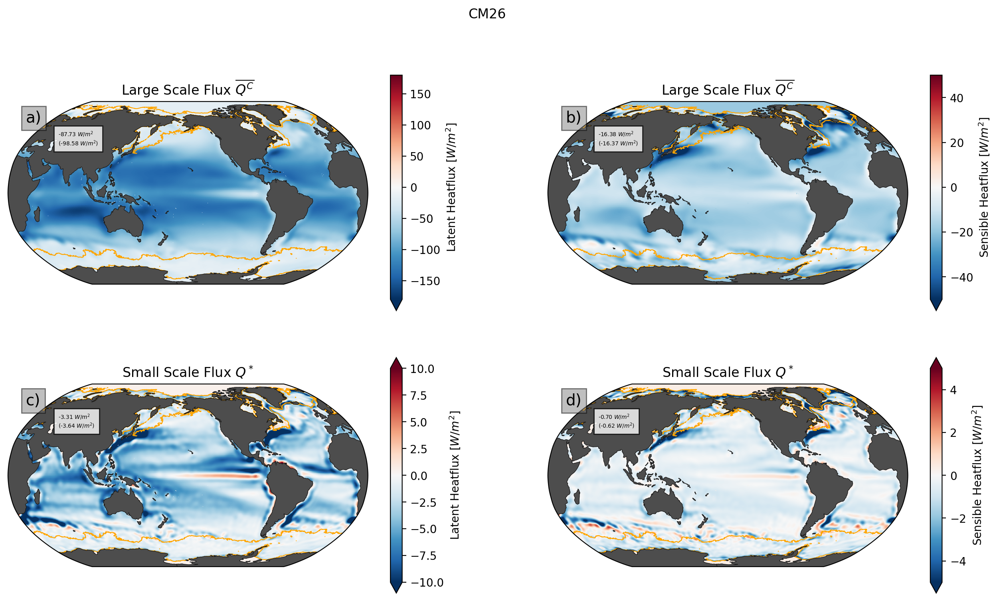

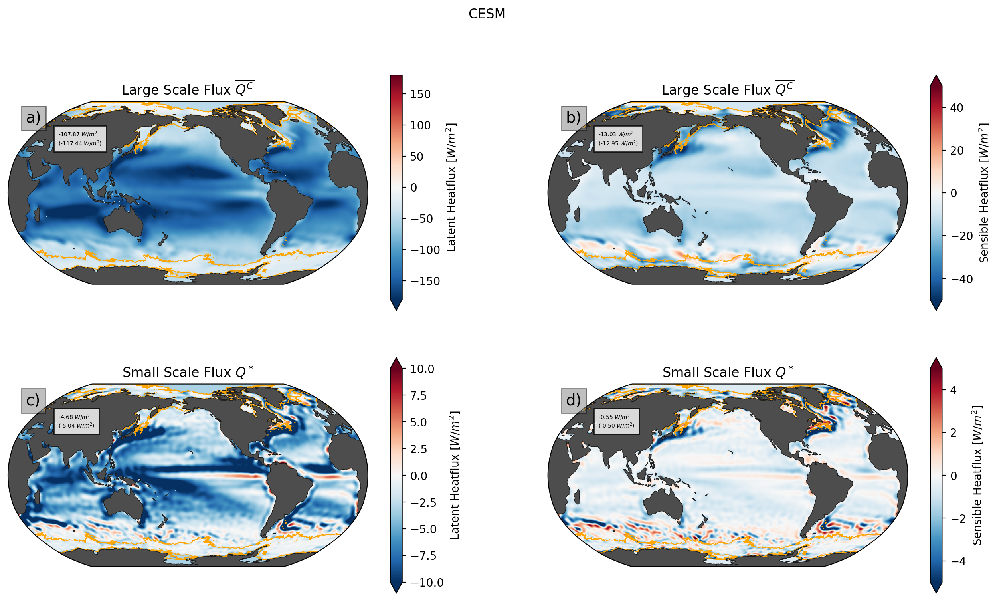

In [ ]:
# appendix version with latent/sensible split
for model in models:
    small_scale_mean_prod = xr.open_dataset(
        params["paths"][model]["results"]["filter"]["mean"]["prod"], **open_kwargs
    )
    ds_plot_mean = add_total(small_scale_mean_prod)
    # recover the large scale term (which I did not save separately)
    Q_L_bar_recovered = (
        ds_plot_mean.sel(term="Q_H_bar") - ds_plot_mean.sel(term="Q_star_star")
    ).assign_coords(term="Q_L_bar")
    ds_plot_mean = xr.concat([ds_plot_mean, Q_L_bar_recovered], dim="term")
    ds_plot_mean = fill_lon_lat(ds_plot_mean)
    fig, axarr = plt.subplots(
        nrows=2,
        ncols=2,
        figsize=[2 * map_width, 2 * map_height],
        subplot_kw=dict(projection=projection),
    )
    for var, axcol in zip(["ql", "qh"], [axarr[:, 0], axarr[:, 1]]):
        for ax, term, vmax, title in [
            # (axcol.flat[0], "Q_H_bar", vmax_dict[var]["full"], "Full Resolution Flux"),
            (axcol.flat[0], "Q_L_bar", vmax_dict[var]["full"], "Large Scale Flux $\overline{Q^C}$"),
            (axcol.flat[1], "Q_star_star", vmax_dict[var]["small"], "Small Scale Flux $Q^*$"),
        ]:
            da_raw = ds_plot_mean[var].sel(term=term, algo=primary_algo)
            ax = map_plot(
                da_raw, ax, label_dict[var], vmax, max_ice_mask[model], fill=False
            )
            ax.set_title(title)
    letter_subplots(axarr, **letter_subplots_kwargs)
    plt.suptitle(model)
    plt.savefig(
        f"figures_submission/appendix_mean_results_{model.lower()}_latent_sensible.png",
        **savefig_kwargs,
    )
    plt.show()

## Decomposition of small scale signal

CM26


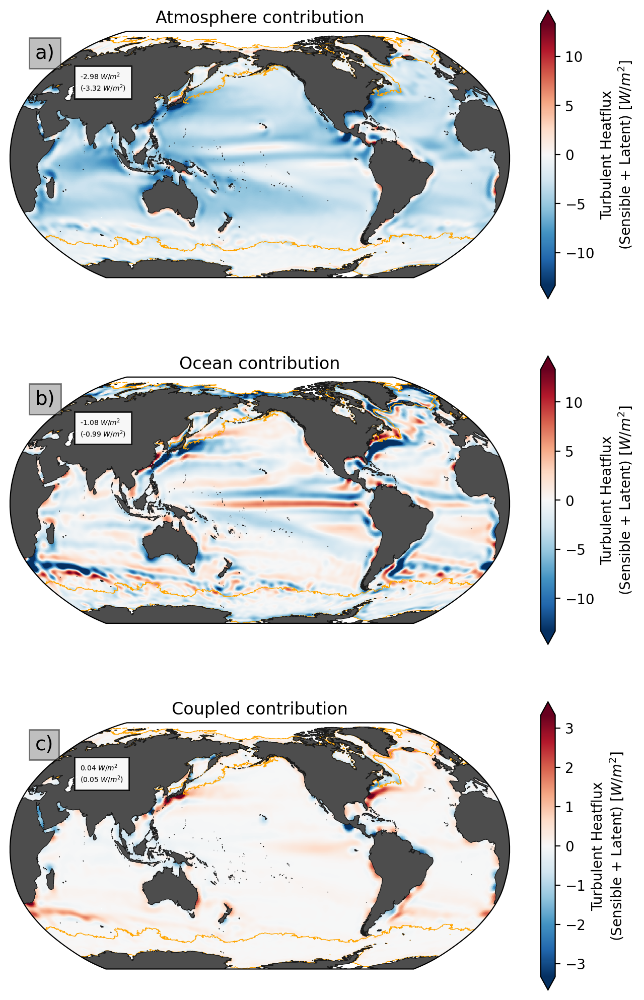

CESM


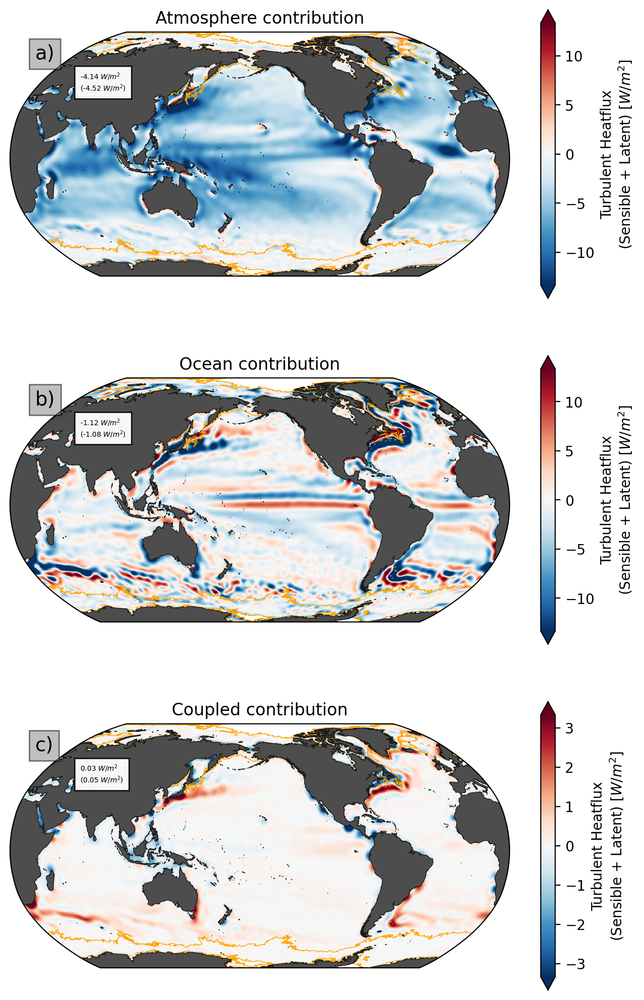

In [ ]:
## manuscript version
for model in models:
    print(model)
    ds_mean_prod = xr.open_dataset(
        params["paths"][model]["results"]["filter"]["mean"]["prod"], **open_kwargs
    )
    ds_mean_prod = add_total(ds_mean_prod)
    fig = decomposition_map_plot(ds_mean_prod, max_ice_mask[model], ["q_total"])
    plt.savefig(f"figures_submission/decomp_{model.lower()}.png", **savefig_kwargs)
    plt.show()

In [ ]:
## NOT USED IN PAPER
for model in models:
    print(model)
    ds_mean_prod = xr.open_dataset(
        params["paths"][model]["results"]["filter"]["mean"]["prod"], **open_kwargs
    )
    ds_mean_prod = add_total(ds_mean_prod)
    fig = decomposition_map_plot(ds_mean_prod, max_ice_mask[model], ["ql", "qh"])
    fig.suptitle(model)
    plt.savefig(
        f"figures/appendix_decomp_{model.lower()}_latent_sensible.png", **savefig_kwargs
    )
    plt.show()

### Compare ocean/atmos decomp to tracer/vel

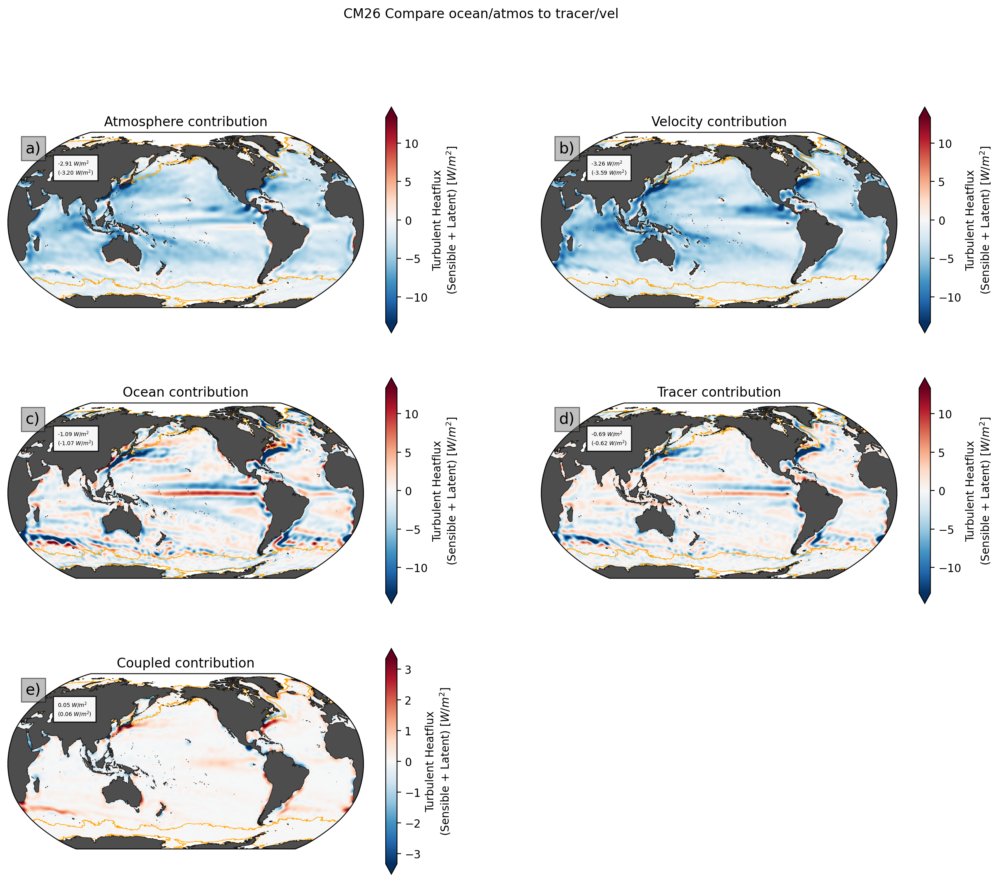

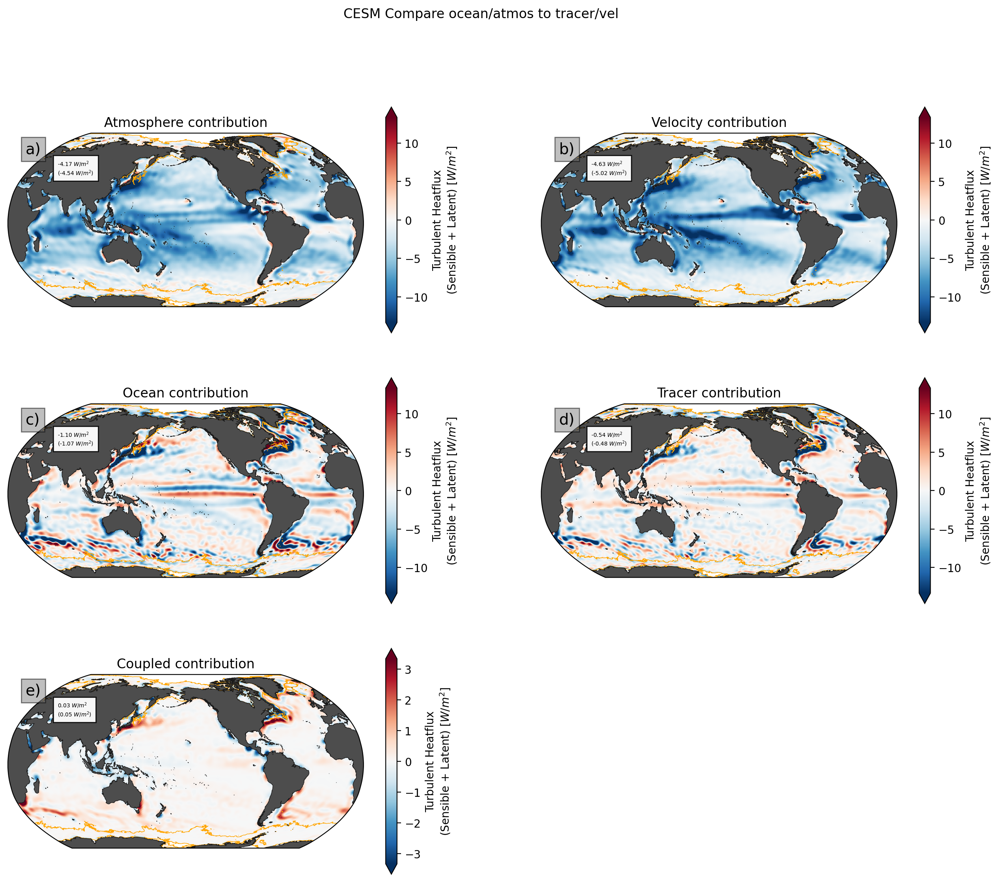

In [ ]:
for model in models:
    # for var in ["ql", "qh", "q_total"]:
    for var in ['q_total']:
        ds_mean_appendix = xr.open_dataset(
            params["paths"][model]["results"]["filter"]["mean"]["appendix"],
            **open_kwargs,
        )
        ds_mean_appendix = add_total(ds_mean_appendix)
        fig, axarr = appendix_decomposition_map_plot(
            ds_mean_appendix, max_ice_mask[model], var
        )
        fig.suptitle(model + " Compare ocean/atmos to tracer/vel")
        axarr.flat[-1].set_visible(False)
        plt.savefig(
            f"figures_submission/ocean_atmos_vs_tracer_vel_{model.lower()}_{var}.png",
            **savefig_kwargs,
        )
        plt.show()

## Appendix: Ice Masking and averaging

In [ ]:
model = "CM26"  # time resolved appendix was not created for CESM

daily_path = params["paths"][model]["results"]["filter"]["native"]["appendix"]
mean_path = params["paths"][model]["results"]["filter"]["mean"]["appendix"]

# The `daily` values have the final spatial filter applied on every time step (very expensive, but can be considered as groundtruth here)
daily = (
    add_total(
        xr.open_dataset(daily_path, engine="zarr", chunks={}).sel(term="Q_star_star")
    )
    .to_array()
    .mean("time")
)
# The `mean` values were averaged before applying the spatial mean (method used for all map plots in paper)
mean = add_total(
    xr.open_dataset(mean_path, engine="zarr", chunks={}).sel(term="Q_star_star")
).to_array()

diff = (daily - mean).load()

/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.35 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.35 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 83.44 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


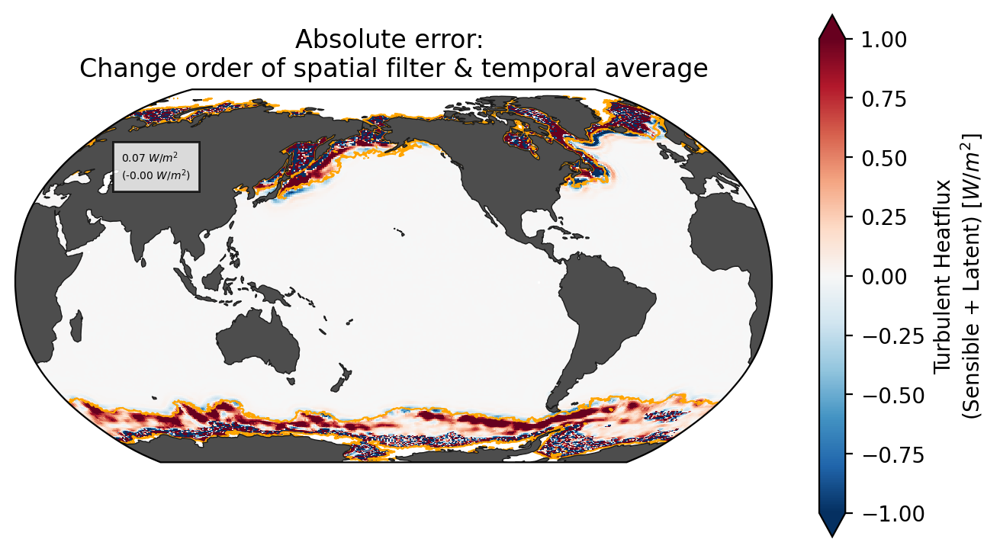

In [ ]:
# The absolute error is small compared to the results presented
fig, ax = plt.subplots(
    subplot_kw=dict(projection=projection), figsize=[map_width, map_height]
)
da_plot = diff.sel(variable="q_total", algo=primary_algo)
map_plot(da_plot, ax, label_dict["q_total"], 1, max_ice_mask[model])
ax.set_title("Absolute error: \nChange order of spatial filter & temporal average")
plt.savefig(
    f"figures_submission/appendix_ice_edge_{model.lower()}_q_total.png",
    **savefig_kwargs,
)
plt.show()

/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.35 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 46.37 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site-packages/distributed/client.py:3157: UserWarning: Sending large graph of size 83.44 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
/srv/conda/envs/notebook/lib/python3.11/site

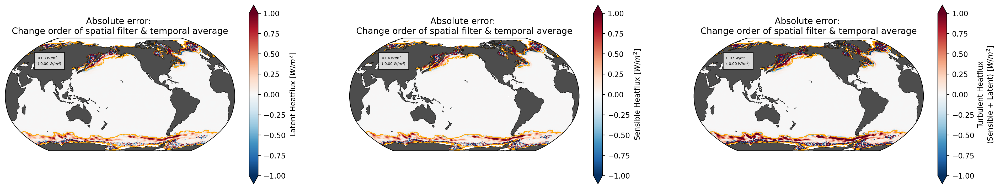

In [ ]:
# The results for latent/sensible separately are very similar (not shown in paper)
fig, axarr = plt.subplots(
    ncols=3, subplot_kw=dict(projection=projection), figsize=[3 * map_width, map_height]
)
for var, ax in zip(["ql", "qh", "q_total"], axarr.flat):
    da_plot = diff.sel(variable=var, algo=primary_algo)
    map_plot(da_plot, ax, label_dict[var], 1, max_ice_mask[model])
    ax.set_title("Absolute error: \nChange order of spatial filter & temporal average")

## 2D histograms

In [26]:
from xhistogram.xarray import histogram

bins = {
    "qh": np.arange(-1200, 300, 3),
    "ql": np.arange(-1200, 300, 3),
    "q_total": np.arange(-1200, 300, 3),
}
small_scale_bins = np.arange(-300, 200, 1)


hist_dict_relative = {}

for model in models:
    path = params["paths"][model]["results"]["filter"]["native"]["appendix"]
    ds_appendix = xr.open_dataset(path, engine="zarr", chunks={})
    ds_appendix["q_total"] = ds_appendix["ql"] + ds_appendix["qh"]
    
    hist_dict_relative[model] = {}
    for var in ["qh", "ql", "q_total"]:
        print(f"Processing Histogram for {model} {var}")
        da_plot = ds_appendix[var]

        highres = da_plot.sel(term="Q_H_bar")
        highres.name = f"High Resolution {var}"

        small_scale = da_plot.sel(term="Q_star_star")
        small_scale.name = f"Small Scale {var}"

        large_scale = highres - small_scale
        large_scale.name = f"Large Scale {var}"

        wbc_mask = mask_boxes(da_plot, wbc_boxes)
        wbc_mask.name = 'WBC_mask'

        # h_rel = histogram(highres, small_scale, bins=[bins[var],  small_scale_bins], dim=['xt_ocean', 'yt_ocean'])
        h = histogram(
            large_scale,
            small_scale,
            wbc_mask, # this splits the results into an additional dimesion (all points outside of wbc boxes, and all within)
            bins=[bins[var], small_scale_bins, np.array([-1,0.5,2])],
            dim=["xt_ocean", "yt_ocean"],
        )
        # avoid that stupid divide by 0 error
        h = h.sum("time")
        hist_dict_relative[model][var] = h.load()

Processing Histogram for CM26 qh
Processing Histogram for CM26 ql
Processing Histogram for CM26 q_total
Processing Histogram for CESM qh
Processing Histogram for CESM ql
Processing Histogram for CESM q_total


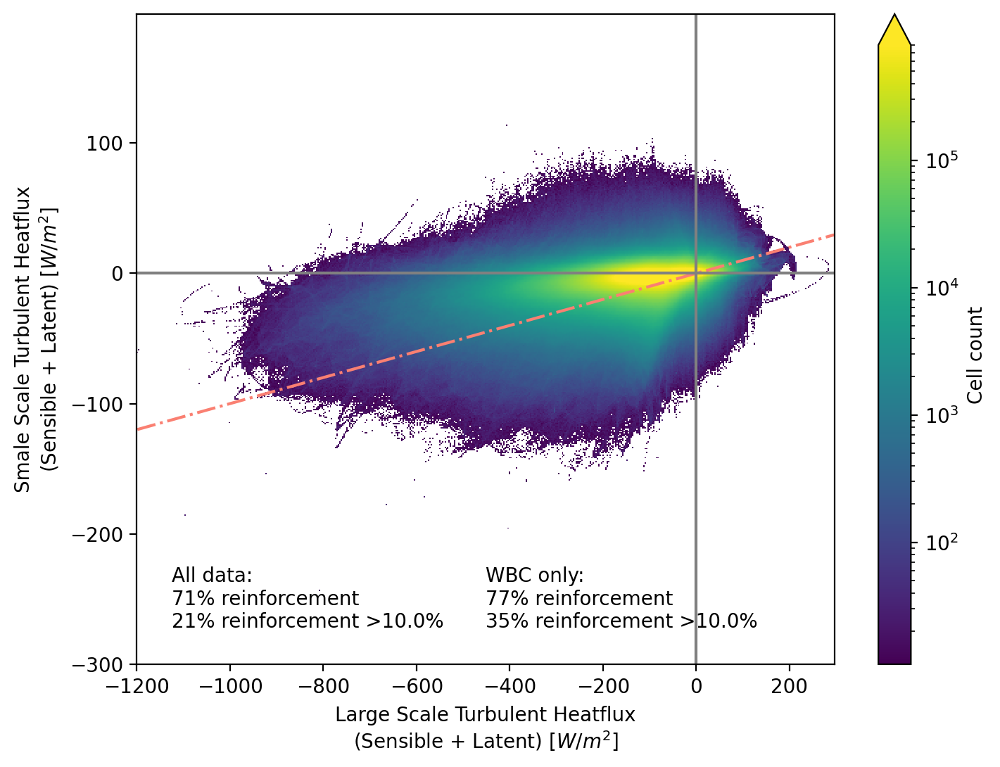

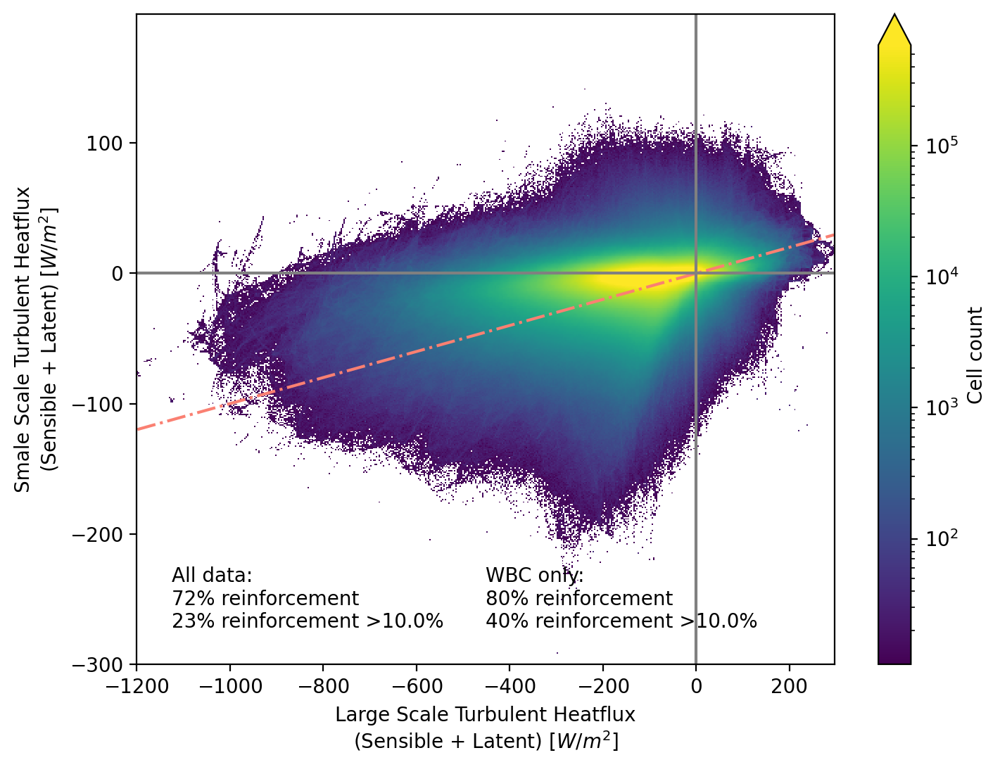

In [ ]:
# for the appendix (maybe)

enforcing_count_dict = {}
for model in models:
    fig, ax = plt.subplots(ncols=1, figsize=[8, 6])
    

    enforcing_count_dict[model] = {}
    var = "q_total"

    h = hist_dict_relative[model][var].sel(algo=primary_algo)
    x_name = f"Large Scale {var}_bin"
    y_name = f"Small Scale {var}_bin"
    x = h[x_name]
    y = h[y_name]

    h_wbc = h.isel(WBC_mask_bin=1)
    h = h.sum("WBC_mask_bin")

    ## quantify the quadrants
    strong_crit = 0.1
    counts_rel = quadrant_count(h, x, y, strong_criterion=strong_crit)
    counts_rel_wbc = quadrant_count(h_wbc, x, y, strong_criterion=strong_crit)
        
    h = h.where(h > 10)
    vmin = h.min()
    vmax=h.quantile(0.99)
    # vmax = 1e6
    norm = colors.LogNorm(vmin=vmin, vmax=vmax)
    h.plot(ax=ax, norm=norm, x=x_name, y=y_name, cbar_kwargs={"label": "Cell count"})

    ax.text(
        0.05,
        0.1,
        f"All data:\n{counts_rel['enforcing']:.0f}% reinforcement \n{counts_rel['strong_enforcing']:.0f}% reinforcement >{strong_crit*100}%",
        horizontalalignment="left",
        verticalalignment="center",
        transform=ax.transAxes,
    )
    ax.text(
        0.5,
        0.1,
        f"WBC only:\n{counts_rel_wbc['enforcing']:.0f}% reinforcement \n{counts_rel_wbc['strong_enforcing']:.0f}% reinforcement >{strong_crit*100}%",
        horizontalalignment="left",
        verticalalignment="center",
        transform=ax.transAxes,
    )

    ax.plot(x, x * strong_crit, ls="-.", color="salmon")
    ax.axhline(0, color="0.5")
    ax.axvline(0, color="0.5")
    ax.set_xlabel(f"Large Scale {label_dict[var]}")
    ax.set_ylabel(f"Small Scale {label_dict[var]}")
    ax.set_title('')
    plt.savefig(f"figures_submission/histogram_{model.lower()}.png", **savefig_kwargs)

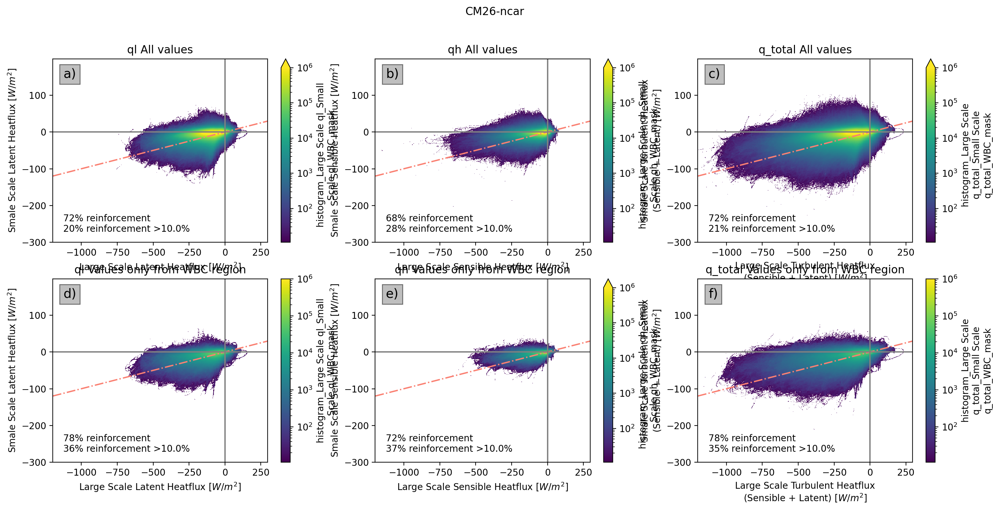

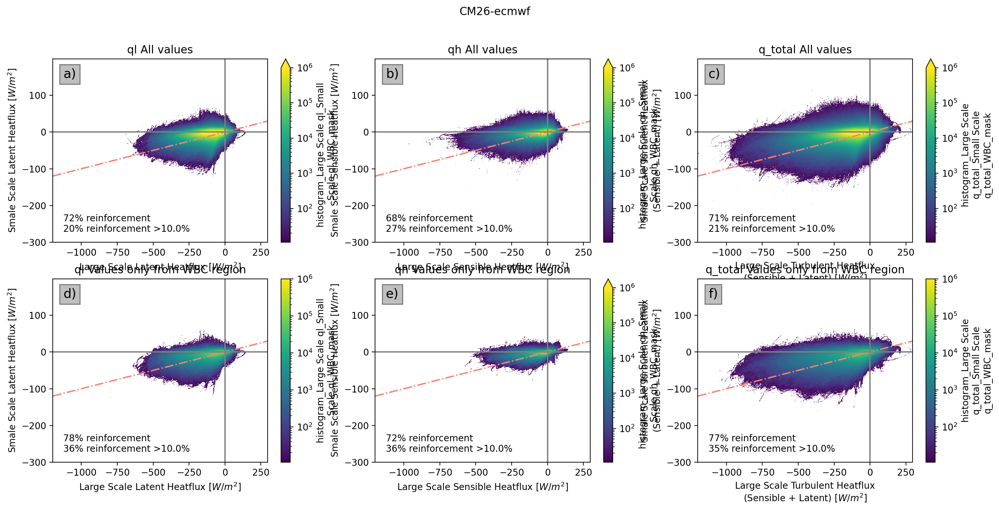

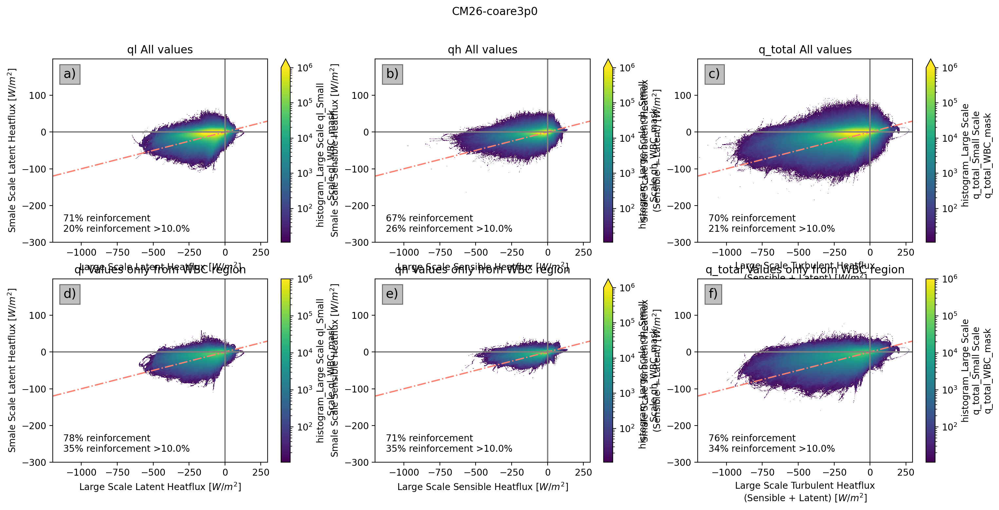

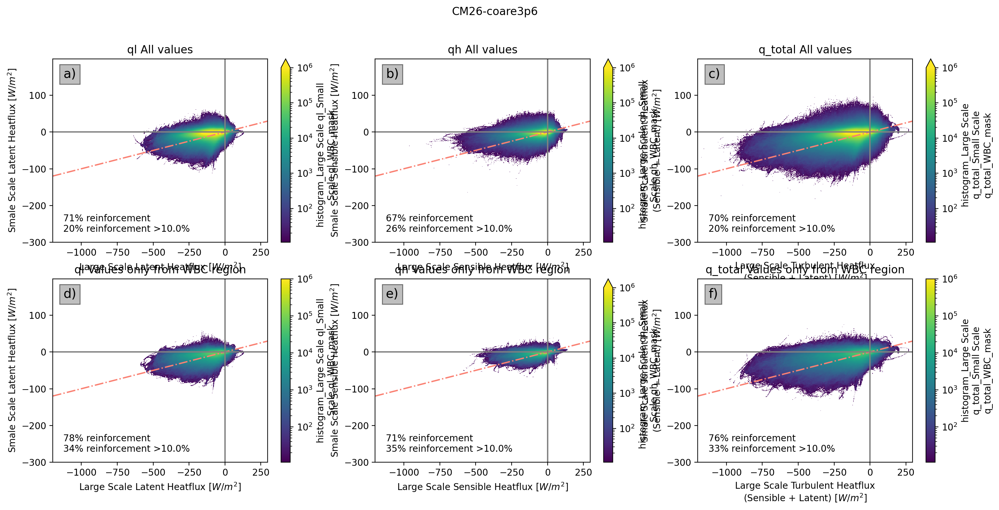

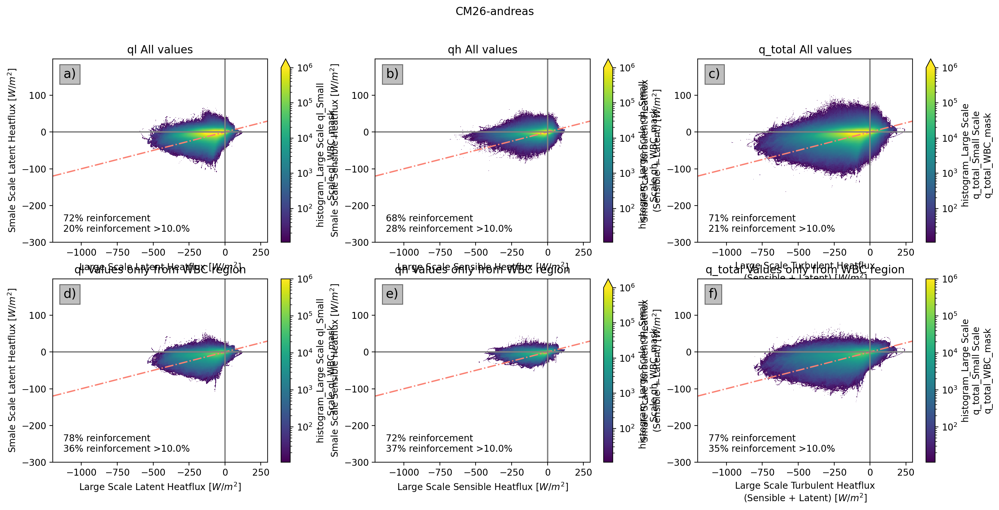

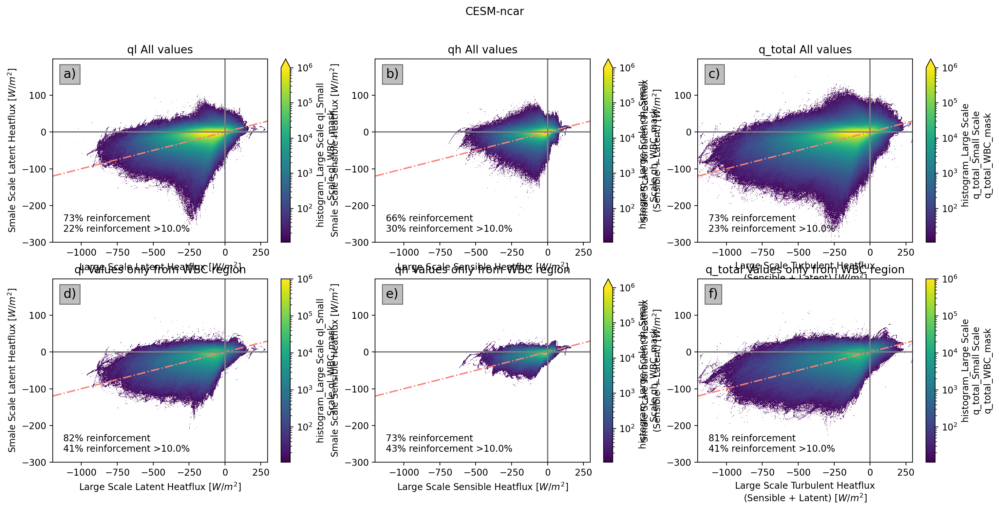

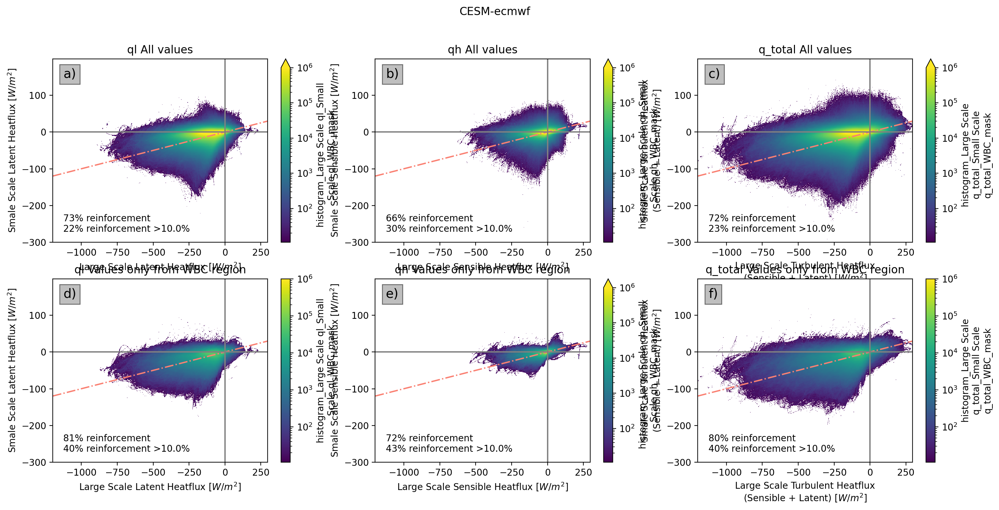

In [ ]:
# Not shown in the paper, but it is really remarkable how consistent 
# the behavior is across all algos and models!!!

enforcing_count_dict = {}
for model in models:
    for algo in hist_dict_relative[model]["ql"].algo.data:
        fig, axarr = plt.subplots(ncols=3, nrows=2, figsize=[18, 8])
        for wbc, axarr_row in zip([False, True], [axarr[0,:], axarr[1,:]]):
            for var, ax in zip(["ql", "qh", "q_total"], axarr_row.flat):
                h = hist_dict_relative[model][var].sel(algo=algo)
                # x_name = f"High Resolution {var}_bin"
                x_name = f"Large Scale {var}_bin"
                y_name = f"Small Scale {var}_bin"
                x = h[x_name]
                y = h[y_name]
    
                # plot
                # need to sum up of pick based on Western Boundary selection
                if wbc:
                    h = h.isel(WBC_mask_bin=1)
                else:
                    h = h.sum("WBC_mask_bin")
        
                ## quantify the quadrants
                strong_crit = 0.1
                counts_rel = quadrant_count(h, x, y, strong_criterion=strong_crit)
    
                # plot
                h = h.where(h > 10)
                vmin = h.min()
                # vmax=h.max()
                vmax = 1e6
                norm = colors.LogNorm(vmin=vmin, vmax=vmax)
                h.plot(ax=ax, norm=norm, x=x_name, y=y_name)
    
                ax.text(
                    0.05,
                    0.1,
                    f"{counts_rel['enforcing']:.0f}% reinforcement \n{counts_rel['strong_enforcing']:.0f}% reinforcement >{strong_crit*100}%",
                    horizontalalignment="left",
                    verticalalignment="center",
                    transform=ax.transAxes,
                )
            
                ax.plot(x, x * strong_crit, ls="-.", color="salmon")
                ax.axhline(0, color="0.5")
                ax.axvline(0, color="0.5")
                ax.set_xlabel(f"Large Scale {label_dict[var]}")
                ax.set_ylabel(f"Small Scale {label_dict[var]}")
                if wbc:
                    ax.set_title(f'{var} Values only from WBC region')
                else:
                    ax.set_title(f'{var} All values')
        letter_subplots(axarr, **letter_subplots_kwargs)
        fig.suptitle(f"{model}-{algo}")
        plt.savefig(
            f"figures/appendix_histogram_{model.lower()}_{algo}.png", **savefig_kwargs
        )

## The last appendix plot: Interannual variability

In [11]:
model = "CM26"
path = params["paths"][model]["results"]["coarse"]["native"]["prod"]
ds_interannual = xr.open_dataset(path, engine="zarr", chunks={})
timeseries = global_ave(add_total(ds_interannual).sel(term="Q_star_star").to_array()).rolling(
    time=360
).mean().load()

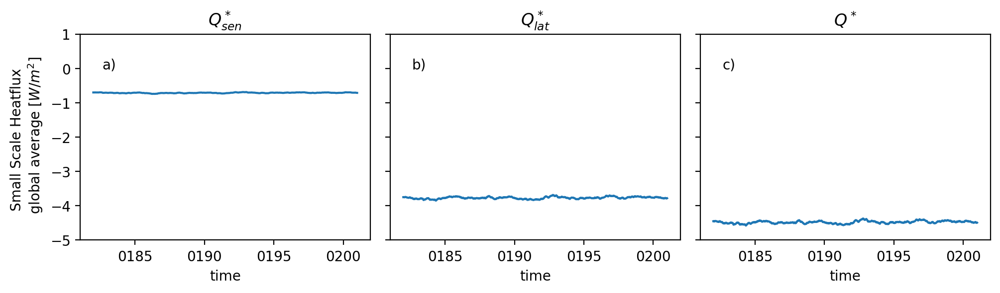

In [25]:
a = timeseries.plot(col="variable")
letter_subplots(a.axs)
for ax, title in zip(a.axs.flat, ['$Q^*_{sen}$', '$Q^*_{lat}$', '$Q^*$']):
    ax.set_title(title)
    ax.set_ylim([-5,1])
    
a.axs.flat[0].set_ylabel('Small Scale Heatflux \n global average [$W/m^2$]')

plt.savefig(f"figures_submission/interannual_{model.lower()}.png", **savefig_kwargs)

## "Unit" plot tests

### mask_boxes

NameError: name 'max_ice_mask' is not defined

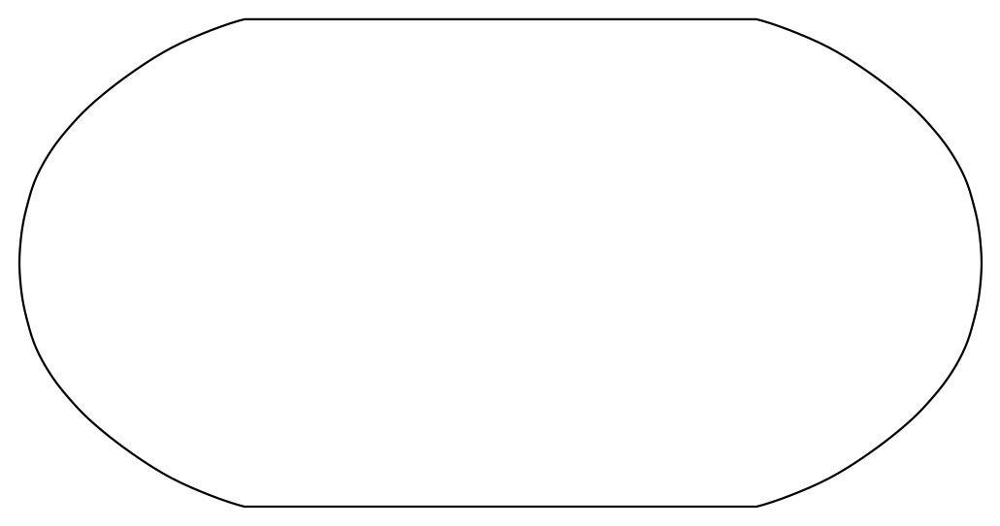

In [9]:
# test 'nan cap' for areas without values
for model in models:
    path = params["paths"][model]["results"]["filter"]["mean"]["appendix"]
    ds = add_total(xr.open_dataset(path, engine="zarr", chunks={}))
    field = ds.isel(algo=0, term=0).q_total.load()
    fig, ax = plt.subplots(subplot_kw={'projection':projection})
    map_plot(field, ax, 'testing: `nan_cap`', 200, max_ice_mask[model], plot_boxes=True)
    ax.set_title(model)

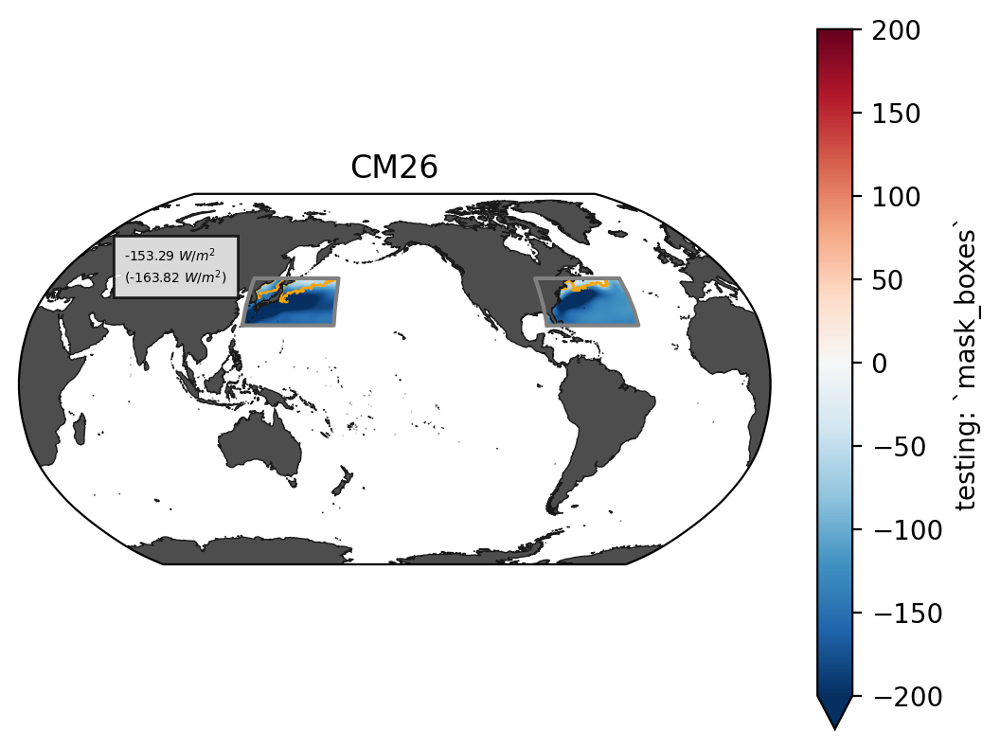

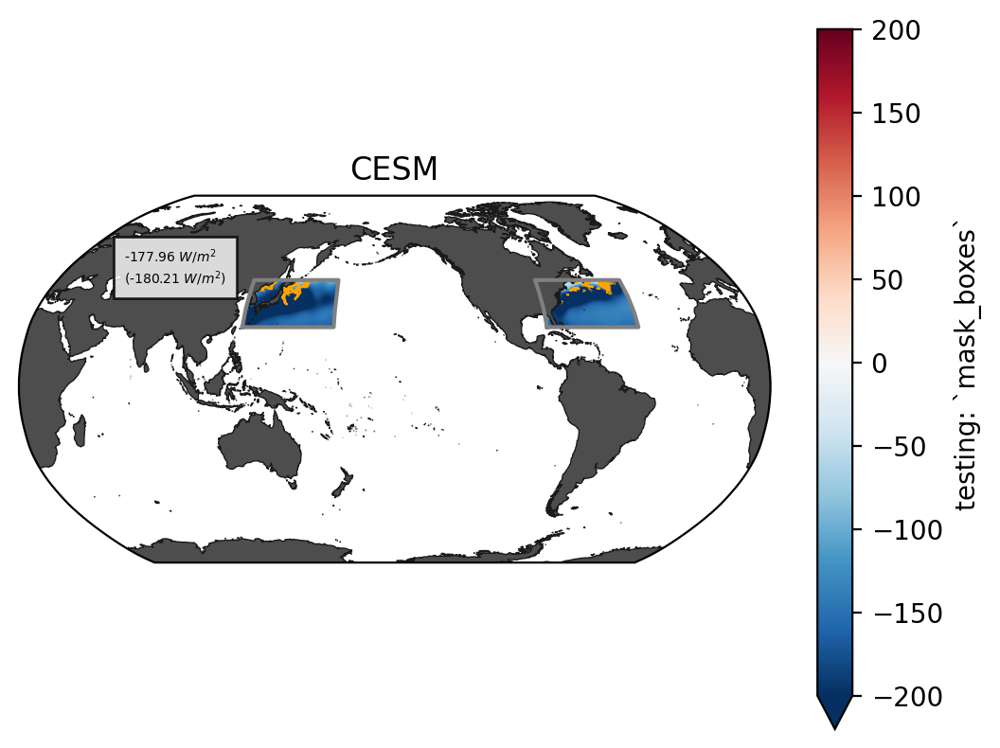

In [16]:
# prototype region selection
for model in models:
    path = params["paths"][model]["results"]["filter"]["mean"]["appendix"]
    ds = add_total(xr.open_dataset(path, engine="zarr", chunks={}))
    field = ds.isel(algo=0, term=0).q_total.load()
    fig, ax = plt.subplots(subplot_kw={'projection':projection})
    map_plot(field.where(mask_boxes(field, wbc_boxes)), ax, 'testing: `mask_boxes`', 200, max_ice_mask[model], plot_boxes=True)
    ax.set_title(model)